# **v1.0 GNN Aarchitecture with 1 hidden layer**

**Version notes:**

- currently the r2 value is low, means that the model is not able to find a suitable relationship to predict the edge weights.
- possibility that GNN is not a suitable model. Try a basic NN, or something else first and see if that improves the r2 value.
- complex relationship, the model might require at least 3 layers and like 50 nodes according to Lisa O:

**Extra**
- possibility that the edge weights might reveal a correlation with another type of un-recorded feature like tree count, road width( but that relates to road hierarchy too), monuments etc. Space Syntax to inform another type of data! Would be an insightful conclusion that space syntax might lead to something else. Thinking of Dietmar's autographic design (MIT)

**Import pytorch geometric**

In [1]:
#!pip install torch torchvision torchaudio
!pip install torch-scatter torch-sparse torch-cluster torch-spline-conv -f https://data.pyg.org/whl/torch-2.1.0+cpu.html
!pip install torch-geometric

Looking in links: https://data.pyg.org/whl/torch-2.1.0+cpu.html
  Using cached torch_scatter-2.1.2.tar.gz (108 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Using cached torch_sparse-0.6.18.tar.gz (209 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Using cached torch_cluster-1.6.3.tar.gz (54 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Using cached torch_spline_conv-1.2.2.tar.gz (25 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Running setup.py clean for torch-scatter
  Running setup.py clean for torch-sparse
  Running setup.py clean for torch-cluster
  Running setup.py clean for torch-spline-conv
Failed to build torch-scatter torch-sparse torch-cluster torch-spline-conv


  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> [31 lines of output]
      running bdist_wheel
      running build
      running build_py
      creating build\lib.win-amd64-cpython-312\torch_scatter
      copying torch_scatter\placeholder.py -> build\lib.win-amd64-cpython-312\torch_scatter
      copying torch_scatter\scatter.py -> build\lib.win-amd64-cpython-312\torch_scatter
      copying torch_scatter\segment_coo.py -> build\lib.win-amd64-cpython-312\torch_scatter
      copying torch_scatter\segment_csr.py -> build\lib.win-amd64-cpython-312\torch_scatter
      copying torch_scatter\testing.py -> build\lib.win-amd64-cpython-312\torch_scatter
      copying torch_scatter\utils.py -> build\lib.win-amd64-cpython-312\torch_scatter
      copying torch_scatter\__init__.py -> build\lib.win-amd64-cpython-312\torch_scatter
      creating build\lib.win-amd64-cpython-312\torch_scatter\composite
      copying torch_scatter\c

##**Create London dataset**

In [2]:
#importing drive and os libraries
#from google.colab import drive
import os
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

#mounting google drive
#Edrive.mount('/content/drive', force_remount=True)



In [3]:
plt.rcParams['figure.dpi'] = 1000


In [4]:
#giving the directory of the files
path = "C:/Users/chalm/Documents/Sem 2/Computational Intelligence/datasets/" # Corrected path to the directory
# using chdir for changing the directory to the path we look for
os.chdir(path)

#reading a comma-separated values (csv) file into DataFrame
df = pd.read_csv("Birmingham_ALL.csv")

**Data Anlaysis for relationships**

In [5]:
df.head()

,tas,metres,meridian_class,nodecount2km,integration2km,nodecount10km,nodecount100km,meridian_class_scale,wkt,geometry,...,end_elev,gradient_pct,abs_gradient,gradient_class,has_memorial,memorial_count,has_trees,trees_count,trees_density,usage_probability
0,116894,36.891733,minor,278,60.937559,9450,228994,1,"LINESTRING(399984 281923,399953 281943)","LINESTRING (399984 281923, 399953 281943)",...,186.0,-2.710634,2.710634,0-3%,No,0,No,0,0.000000,0.348408
1,116895,37.121422,minor,276,57.056102,9412,228908,1,"LINESTRING(399953 281943,399990 281940)","LINESTRING (399953 281943, 399990 281940)",...,185.0,-2.693862,2.693862,0-3%,No,0,Yes,1,0.026939,0.351047
2,113868,27.802878,minor,316,53.582789,5600,225752,1,"LINESTRING(399870 277371,399848 277354)","LINESTRING (399870 277371, 399848 277354)",...,NaN,NaN,NaN,NaN,No,0,No,0,0.000000,0.268286
3,113054,461.278658,aroad,386,130.864063,6483,214338,3,"LINESTRING(400343 277539,400796 277452)","LINESTRING (400343 277539, 400796 277452)",...,NaN,NaN,NaN,NaN,No,0,Yes,23,0.049861,0.639661
4,113055,98.005102,aroad,329,120.587794,6363,214909,3,"LINESTRING(400173 277544,400271 277545)","LINESTRING (400173 277544, 400271 277545)",...,179.0,3.061065,3.061065,3-5%,No,0,Yes,7,0.071425,0.610667


In [ ]:
# Drop the columns that are disallowed (choice*, integration100km, etc.)
excluded_keywords = ['choice', 'integration100km', 'integration10km', 'rank']
columns_to_include = [col for col in df.columns if not any(key in col.lower() for key in excluded_keywords)]

# Filter dataframe
filtered_df = df[columns_to_include]

# Select only numerical columns
numerical_df = filtered_df.select_dtypes(include='number')

# Compute full correlation matrix
correlation_matrix = numerical_df.corr()

# Plotting the correlation matrix as a heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True, linewidths=0.5)
plt.title('Correlation Matrix of Filtered Numerical Features')
plt.tight_layout()
plt.show()

**Prepare syntax graph for GNN tensors**

In [7]:
import torch
from torch_geometric.data import Data


In [8]:
from shapely import wkt

# Convert geometry WKT column to GeoSeries
gs = gpd.GeoSeries.from_wkt(df['wkt'])

# Create a proper GeoDataFrame (CRS optional but recommended)
london_gdf = gpd.GeoDataFrame(df, geometry=gs, crs="EPSG:27700")

london_gdf['src_coord'] = london_gdf['geometry'].apply(lambda g: (g.coords[0][0], g.coords[0][1]))
london_gdf['dst_coord'] = london_gdf['geometry'].apply(lambda g: (g.coords[-1][0], g.coords[-1][1]))


# 2. Assign each unique coordinate an integer node ID
unique_coords = pd.Series(pd.concat([london_gdf['src_coord'], london_gdf['dst_coord']]).unique())
coord_to_node = {coord: i for i, coord in enumerate(unique_coords)}

# 3. Build edge index
src_nodes = london_gdf['src_coord'].map(coord_to_node).tolist()
dst_nodes = london_gdf['dst_coord'].map(coord_to_node).tolist()
edge_index = torch.tensor([src_nodes, dst_nodes], dtype=torch.long)

# 4. Extract edge weights
edge_weights = torch.tensor(london_gdf['usage_probability'].values, dtype=torch.float)

#add in nodecount2km and meridian_class_scale as additional features
edge_attr = torch.tensor(
    london_gdf[['integration2km', 'nodecount2km', 'meridian_class_scale', 'trees_density', 'memorial_count']].values,
    dtype=torch.float
)


# 5. Build node features — we'll use raw coordinates for now
node_coords = torch.tensor([list(coord) for coord in unique_coords], dtype=torch.float)
node_features = node_coords  # 2D coordinate features

# Summary
num_nodes = node_features.shape[0]
num_edges = edge_index.shape[1]

num_nodes, num_edges

#data = Data(x=node_features, edge_index=edge_index)

data = Data(x=node_features, edge_index=edge_index, edge_attr=edge_attr, y=edge_weights)



##**Create GNN class**

In [9]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torch_geometric.nn import GCNConv
from torch_geometric.data import Data

# ----------------------------
# ✅ Regularized GNN Model
# ----------------------------
class EdgeWeightGNN(nn.Module):
    def __init__(self, in_channels, hidden1, embedding_dim, dropout_prob=0.3):
        super().__init__()
        self.conv1 = GCNConv(in_channels, hidden1)
        self.bn1 = nn.BatchNorm1d(hidden1)
        self.dropout = nn.Dropout(dropout_prob)
        self.conv2 = GCNConv(hidden1, embedding_dim)

        self.edge_mlp = nn.Sequential(
            nn.Linear(embedding_dim * 2, 32),
            nn.ReLU(),
            nn.Dropout(dropout_prob),
            nn.Linear(32, 1)
        )

    def forward(self, data):
        x, edge_index = data.x, data.edge_index

        x = self.conv1(x, edge_index)
        x = self.bn1(x)
        x = F.relu(x)
        x = self.dropout(x)

        x = self.conv2(x, edge_index)

        src, dst = edge_index
        edge_repr = torch.cat([x[src], x[dst]], dim=1)
        edge_pred = self.edge_mlp(edge_repr).squeeze()

        return edge_pred, x

# ----------------------------
# ✅ Train/Test Split
# ----------------------------
"""
# Shuffle edge indices before training
perm = torch.randperm(edge_index.shape[1])
edge_index = edge_index[:, perm]
edge_weights = edge_weights[perm]

num_edges = edge_index.shape[1]
num_train = int(0.8 * num_edges)

train_edge_index = edge_index[:, :num_train]
train_edge_weights = edge_weights[:num_train]
test_edge_index = edge_index[:, num_train:]
test_edge_weights = edge_weights[num_train:]"
"""

# Sort edges by weight
sorted_weights, sorted_indices = torch.sort(edge_weights, descending=True)

# Stratify: manually define bins
# top 10% = high, next 20% = mid, bottom 70% = low
num_edges = edge_weights.shape[0]
high_idx = sorted_indices[:int(0.1 * num_edges)]
mid_idx = sorted_indices[int(0.1 * num_edges):int(0.3 * num_edges)]
low_idx = sorted_indices[int(0.3 * num_edges):]

# Now shuffle within each bin
high_perm = high_idx[torch.randperm(high_idx.shape[0])]
mid_perm = mid_idx[torch.randperm(mid_idx.shape[0])]
low_perm = low_idx[torch.randperm(low_idx.shape[0])]

# Split 80-20 within each bin
def split_indices(indices, train_ratio=0.8):
    n = indices.shape[0]
    n_train = int(train_ratio * n)
    return indices[:n_train], indices[n_train:]

high_train, high_test = split_indices(high_perm)
mid_train, mid_test = split_indices(mid_perm)
low_train, low_test = split_indices(low_perm)

# Merge final splits
train_indices = torch.cat([high_train, mid_train, low_train])
test_indices = torch.cat([high_test, mid_test, low_test])

# Shuffle final sets (optional)
train_indices = train_indices[torch.randperm(train_indices.shape[0])]
test_indices = test_indices[torch.randperm(test_indices.shape[0])]

# Get final edge_index and weights
train_edge_index = edge_index[:, train_indices]
train_edge_weights = edge_weights[train_indices]
test_edge_index = edge_index[:, test_indices]
test_edge_weights = edge_weights[test_indices]



##**Train**

Epoch   0 | Train Loss: 0.2072 | Val Loss: 46.7497
Epoch  25 | Train Loss: 0.0368 | Val Loss: 0.3895
Epoch  50 | Train Loss: 0.0316 | Val Loss: 0.1139
Epoch  75 | Train Loss: 0.0296 | Val Loss: 0.0485
Epoch 100 | Train Loss: 0.0288 | Val Loss: 0.0362
Epoch 125 | Train Loss: 0.0284 | Val Loss: 0.0281
Epoch 150 | Train Loss: 0.0279 | Val Loss: 0.0279
Epoch 175 | Train Loss: 0.0278 | Val Loss: 0.0280
Epoch 200 | Train Loss: 0.0275 | Val Loss: 0.0280
Epoch 225 | Train Loss: 0.0273 | Val Loss: 0.0289
Epoch 250 | Train Loss: 0.0270 | Val Loss: 0.0289
Epoch 275 | Train Loss: 0.0265 | Val Loss: 0.0341
Epoch 299 | Train Loss: 0.0265 | Val Loss: 0.0282


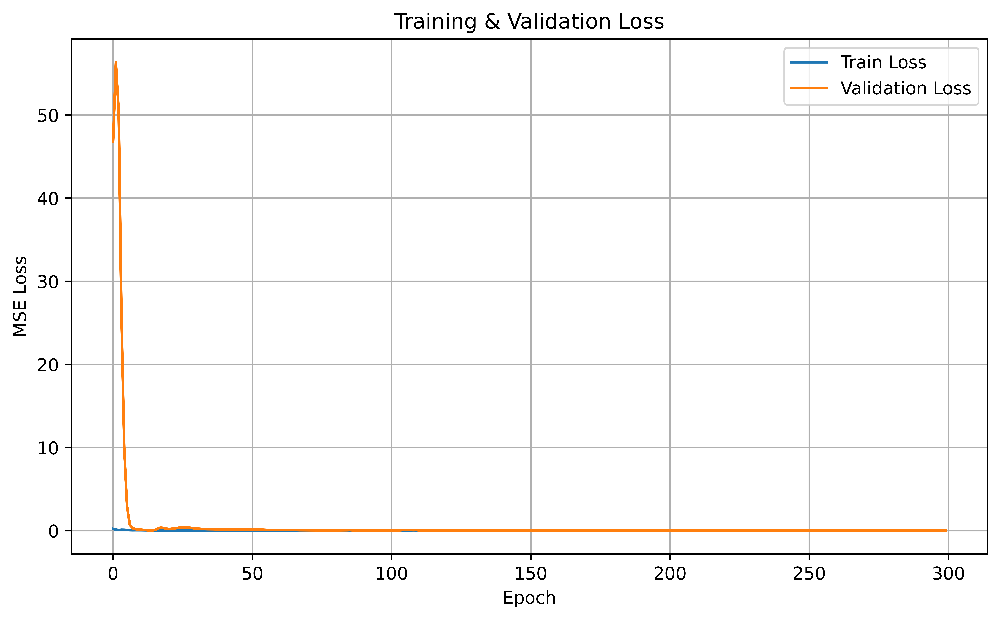

In [10]:

# ----------------------------
# ✅ Model Setup
# ----------------------------
model = EdgeWeightGNN(in_channels=2, hidden1=16, embedding_dim=8, dropout_prob=0.3)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01, weight_decay=5e-4)
loss_fn = nn.MSELoss()

train_loss_history = []
val_loss_history = []

# ----------------------------
# ✅ Training Loop
# ----------------------------
for epoch in range(300):
    model.train()
    optimizer.zero_grad()
    
    data.edge_index = train_edge_index
    train_pred, _ = model(data)
    train_loss = loss_fn(train_pred, train_edge_weights)
    train_loss.backward()
    optimizer.step()
    train_loss_history.append(train_loss.item())

    model.eval()
    with torch.no_grad():
        data.edge_index = test_edge_index
        val_pred, _ = model(data)
        val_loss = loss_fn(val_pred, test_edge_weights)
        val_loss_history.append(val_loss.item())

    if epoch % 25 == 0 or epoch == 299:
        print(f"Epoch {epoch:3d} | Train Loss: {train_loss.item():.4f} | Val Loss: {val_loss.item():.4f}")

# ----------------------------
# ✅ Loss Plot
# ----------------------------
plt.figure(figsize=(8, 5))
plt.plot(train_loss_history, label='Train Loss')
plt.plot(val_loss_history, label='Validation Loss')
plt.title("Training & Validation Loss")
plt.xlabel("Epoch")
plt.ylabel("MSE Loss")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

**Regression evaluation metrics**

**MAE** — How far off the predictions are on average.

**MSE** — Penalizes large errors more heavily.

**RMSE** — Same as MSE but in the same units as the target.

**R² Score** — Indicates how well the model explains the variance in the data (1 = perfect prediction, 0 = mean predictor).

##**Visualize output**

In [11]:
# Evaluation
model.eval()
with torch.no_grad():
    data.edge_index = test_edge_index  # Only predict on test edges
    test_pred_weights, node_emb = model(data)
    test_pred = test_pred_weights.detach().numpy()
    test_truth = test_edge_weights.numpy()

    from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

    mae = mean_absolute_error(test_truth, test_pred)
    mse = mean_squared_error(test_truth, test_pred)
    rmse = mse ** 0.5
    r2 = r2_score(test_truth, test_pred)

    print("📊 Evaluation Metrics on Test Set:")
    print(f"MAE  (Mean Absolute Error)      : {mae:.4f}")
    print(f"MSE  (Mean Squared Error)       : {mse:.4f}")
    print(f"RMSE (Root Mean Squared Error)  : {rmse:.4f}")
    print(f"R²   (R-squared score)          : {r2:.4f}")


📊 Evaluation Metrics on Test Set:
MAE  (Mean Absolute Error)      : 0.1370
MSE  (Mean Squared Error)       : 0.0282
RMSE (Root Mean Squared Error)  : 0.1680
R²   (R-squared score)          : -0.0081


In [25]:
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize

def compare_predictions(dataframe, location, true_col, pred_col, geometry_col='wkt', crs='EPSG:27700'):
    # Convert to GeoDataFrame if not already
    #dataframe = dataframe[dataframe['lad11nm'] == location]
    gs = gpd.GeoSeries.from_wkt(dataframe[geometry_col])
    gdf = gpd.GeoDataFrame(dataframe, geometry=gs, crs=crs)

    # Determine common color scale
    vmin = min(gdf[true_col].min(), gdf[pred_col].min())
    vmax = max(gdf[true_col].max(), gdf[pred_col].max())

    norm = Normalize(vmin=vmin, vmax=vmax)

    # Plot side-by-side
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))

    gdf.plot(column=true_col, cmap='viridis', legend=True, ax=axes[0], norm=norm, linewidth=0.5)
    axes[0].set_title(f"Usage Probability (Ground Truth)")
    #axes[0].axis('off')
    axes[0].grid(True, alpha=0.3, linewidth = 0.2)

    gdf.plot(column=pred_col, cmap='viridis', legend=True, ax=axes[1], norm=norm, linewidth=0.5)
    axes[1].set_title(f"Usage Probability (Predicted)")
    #axes[1].axis('off')
    axes[1].grid(True, alpha=0.3, linewidth = 0.2)

    plt.tight_layout()
    plt.show()

model.eval()
with torch.no_grad():
    data.edge_index = edge_index  # use full edge list
    all_pred_weights, _ = model(data)

# Now `all_pred_weights` will have same length as total edges (same as df rows)
df['predicted_integration'] = all_pred_weights.detach().cpu().numpy()

base_path = r"C:\Users\chalm\Documents\Sem 2\Computational Intelligence\SpaceSyntax_UK\csv"
output_path = os.path.join(base_path, "london_predicted.csv")
df.to_csv(output_path, index=False)

# Then visualize side-by-side maps:
compare_predictions(df, 'london_combined', true_col='usage_probability', pred_col='predicted_integration')


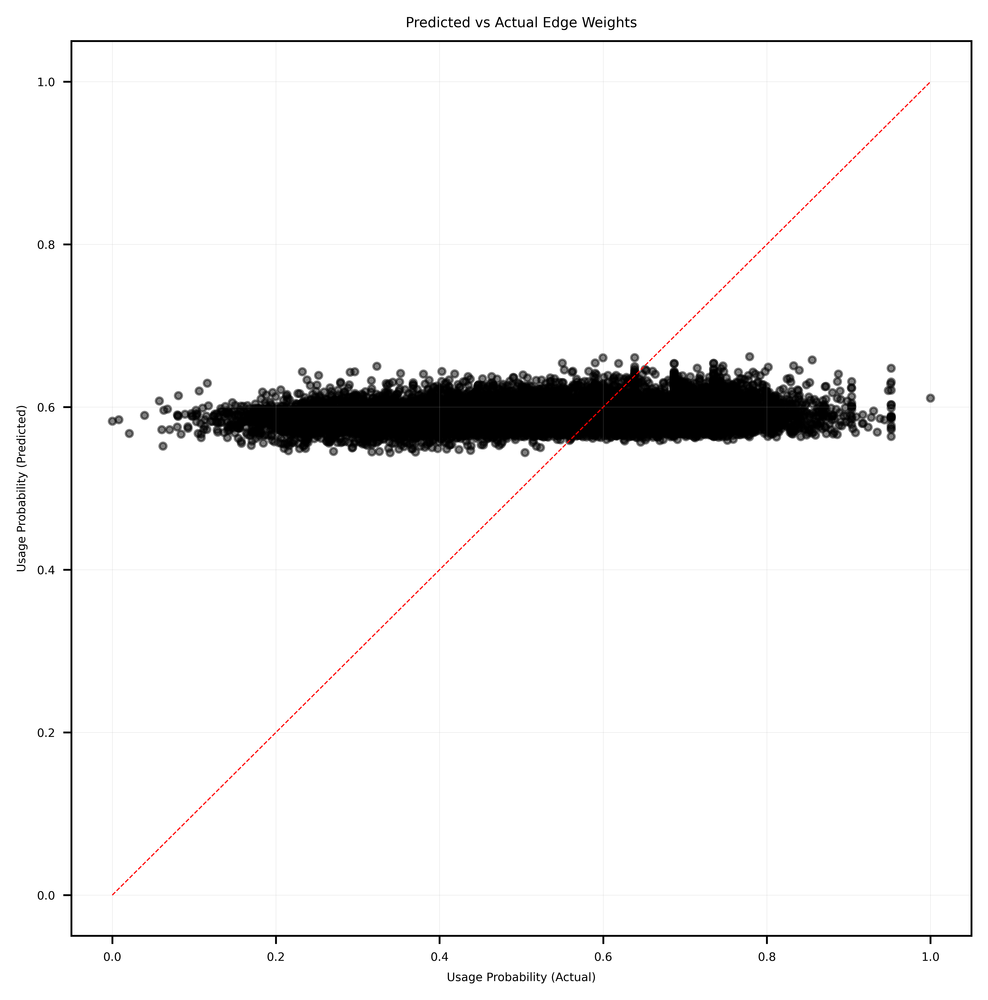

In [26]:
# Ensure tensors are on CPU and converted to NumPy
actual = np.array(df['usage_probability'])
predicted = np.array(df['predicted_integration'])

# Plot
plt.figure(figsize=(7, 7))
plt.scatter(actual, predicted, alpha=0.5, marker='.', color = 'black')
plt.plot([actual.min(), actual.max()], [actual.min(), actual.max()], 'r--', linewidth = 0.5)  # y = x line
plt.xlabel('Usage Probability (Actual)')
plt.ylabel('Usage Probability (Predicted)')
plt.title('Predicted vs Actual Edge Weights')
plt.grid(True, alpha = 0.3, linewidth = 0.2)
plt.show()


In [20]:
df['residual'] = (
    df['usage_probability'] - df['predicted_integration']
)

In [23]:
plt.rcParams['figure.dpi'] = 1000

plt.rcParams.update({'font.size':5})

<Figure size 12000x8000 with 0 Axes>

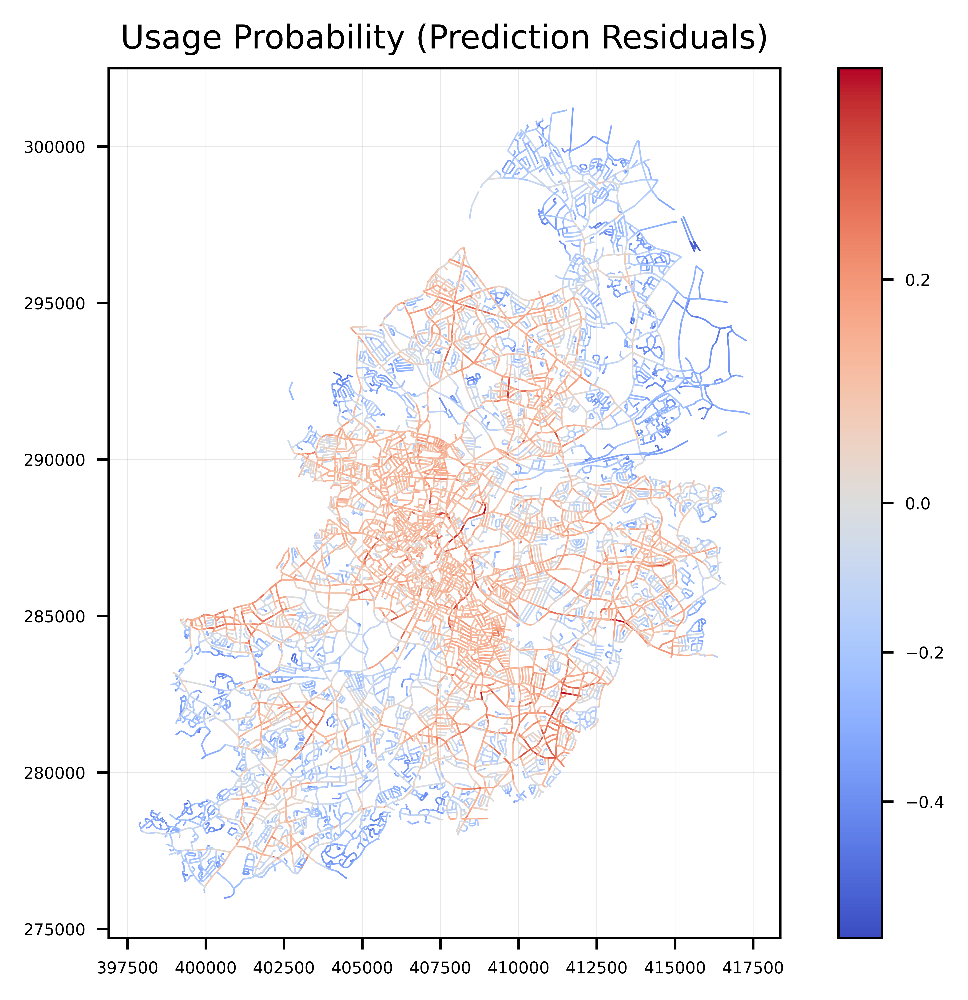

In [24]:
import geopandas as gpd
from matplotlib.colors import Normalize, TwoSlopeNorm

def plot_residuals(gdf, residual_col='residual', geometry_col='geometry', crs='EPSG:27700'):
    gs = gpd.GeoSeries.from_wkt(gdf[geometry_col]) if gdf[geometry_col].dtype == 'object' else gdf[geometry_col]
    gdf = gpd.GeoDataFrame(gdf, geometry=gs, crs=crs)

    # Use diverging color scale centered at 0
    vmin = gdf[residual_col].min()
    vmax = gdf[residual_col].max()
    norm = TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)

    plt.figure(figsize=(12, 8))
    gdf.plot(column=residual_col, cmap='coolwarm', legend=True, norm=norm, linewidth = 0.5)
    plt.title("Usage Probability (Prediction Residuals)", fontsize=10)
    #plt.axis('off')
    plt.grid(True, alpha=0.3, linewidth = 0.2)
    plt.show()

# Call it
plot_residuals(df)